In [9]:
from __future__ import division
%matplotlib inline
import os
import traceback
import json
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
from tabulate import tabulate
from collections import defaultdict, Counter
import scipy.fftpack as fft
from helper_functions import getListOfFiles, getCSV, getStatistics

# Testing Fourrier Transform

### Loading a csv.

In [17]:
csv_dir = "./data"
files = getListOfFiles(csv_dir, ".csv")
print ">> {} CSV Files found:\n".format(len(files))
print

csv_filename = files[0]  # get only the fist loaded csv file.
csv_data = None          # the variable where the loaded csv data is stored.
num_windows = 0          # the number of windows loaded.
wFrames = []             # the list of windows data. Each element is a pandas dataframe 
                         #  corresponding to the windows. The list is of size 'num_windows'.

# variable for storing the loaded feature names.
feature_name_map = {
  "time" : "time",
  "Control": "control",
  "High_level": "high_level",
  "Expectation": "expectation",
  "Activity": "activity",
  "/kinect_features/.ci": "ci",
  "/kinect_features/.distance": "distance",
  "/kinect_features/.proximity": "proximity",
  "robogame/imu_state.gyro.x": "gyroX",
  "robogame/imu_state.gyro.y": "gyroY",
  "robogame/imu_state.gyro.z": "gyroZ",
  "robogame/imu_state.linear_acc.x": "accX",
  "robogame/imu_state.linear_acc.y": "accY",
  "robogame/imu_state.linear_acc.z": "accZ"
}

ignore_col_list = [k for k,v in feature_name_map.items() if v is ""]
print "List of ignored topics: {}".format(ignore_col_list) 
    
print 'Processing: "{}"'.format(csv_filename)

# load the data, abort in case of error.
try:
    num_windows, csv_data = getCSV(os.path.join(csv_dir, csv_filename))
except ValueError as e:
    print traceback.format_exc()
    sys.exit(-1)

for w in range(num_windows):
    win_data = {}
    for k in csv_data.keys():
        # consider the data only if it is not in the ignore list.
        if k not in ignore_col_list:
            win_data[feature_name_map[k]] = csv_data[k][w]

    # convert dictionary to dataframe and save it to list of all windows data for the file.
    wFrames.append(pd.DataFrame.from_dict(win_data))
print 'Retrieved {} windows in {}'.format(num_windows, csv_filename)
overlap_reference = 50
_, n_windows, sample_info, avg_overlap, avg_diff = getStatistics(csv_data, compareWith=overlap_reference)

print "LOAD SUMMARY:"
print tabulate([[n_windows,"{:.2f}".format(avg_overlap),"{:.2f}".format(avg_diff)]],
                   headers=["#Win", "Avg. Overlap", "Avg. dev. from ref."])

>> 34 CSV Files found:


List of ignored topics: []
Processing: "_2016-11-23-18-49-13_exp1_Player.csv"
Retrieved 24 windows in _2016-11-23-18-49-13_exp1_Player.csv
LOAD SUMMARY:
  #Win    Avg. Overlap    Avg. dev. from ref.
------  --------------  ---------------------
    24           49.99                  -0.01


## Calculating the FFT for a window signal

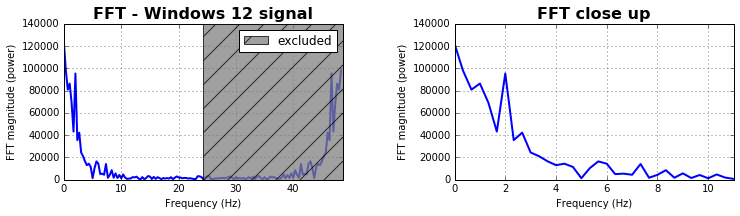

In [28]:
win_number = 12

sig = wFrames[win_number]["accX"].dropna()
N_samps = len(sig)
Fs = len(sig)/3
N_fft = len(sig)         # Number of bins (chooses granularity)
T = 1./Fs          #the period, the sample time, the time after which each data come.
t  = np.linspace(0,N_samps*T,N_samps) # N_samps*T (#samples x sample period) is the signal time.


freqsig = fft.fft(sig,n=N_fft) 
freq_axis = np.arange(0,Fs,Fs/N_fft)

##### FFT of the signal #####
fig = plt.figure(figsize=[12,7])
plt.subplots_adjust(hspace=0.5, wspace= 0.4)
ax = plt.subplot(221)
pt, = ax.plot(freq_axis,np.abs(freqsig), lw=2.0, c='b')
p = plt.Rectangle((Fs/2, 0), Fs/2, ax.get_ylim()[1], facecolor="grey", fill=True, alpha=0.75, hatch="/", zorder=3)
ax.add_patch(p)
ax.set_xlim((ax.get_xlim()[0],Fs))
ax.set_title('FFT - Windows {} signal'.format(win_number), fontsize= 16, fontweight="bold")
ax.set_ylabel('FFT magnitude (power)')
ax.set_xlabel('Frequency (Hz)')
plt.legend((p,), ('excluded',))
ax.grid()

##### Close up on the graph #######
# This is the same histogram above, but truncated at the max frequence + an offset. 
offset = 5    # just to help the visualization. Nothing important.
ax2 = fig.add_subplot(222)
ax2.set_xlim(0,int(Fs/8)+offset)
ax2.plot(freq_axis,np.abs(freqsig), lw=2.0, c='b')
ax2.set_title('FFT close up', fontsize= 16, fontweight="bold")
ax2.set_ylabel('FFT magnitude (power)')
ax2.set_xlabel('Frequency (Hz)')
ax2.hold(True)
ax2.grid()

## Recovering the data back: IFFT!

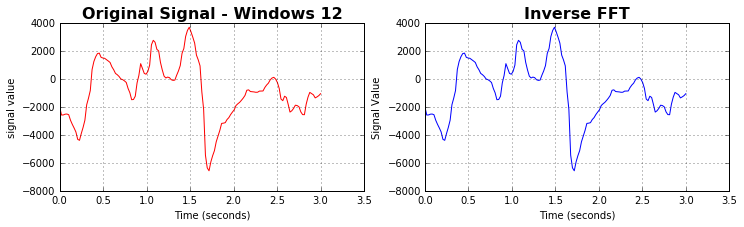

In [27]:
#### Ploting the original signal ####
fig = plt.figure(figsize=[12,3])
ax3 = fig.add_subplot(121)
ax3.set_title('Original Signal - Windows {}'.format(win_number), fontsize= 16, fontweight="bold")
ax3.set_xlabel('Time (seconds)')
ax3.set_ylabel('signal value')
ax3.hold(True)
ax3.plot(t,sig,'r')
ax3.grid()

######  Plotting the inverse fft from the fft calculation #########
recsig = fft.ifft(freqsig,n=N_fft)
ax4 = fig.add_subplot(122)
ax4.plot(t,recsig, c='b')
ax4.set_title('Inverse FFT', fontsize= 16, fontweight="bold")
ax4.set_ylabel('Signal Value')
ax4.set_xlabel('Time (seconds)')
ax4.hold(True)
ax4.grid()
plt.show()

## A better view of what is happening


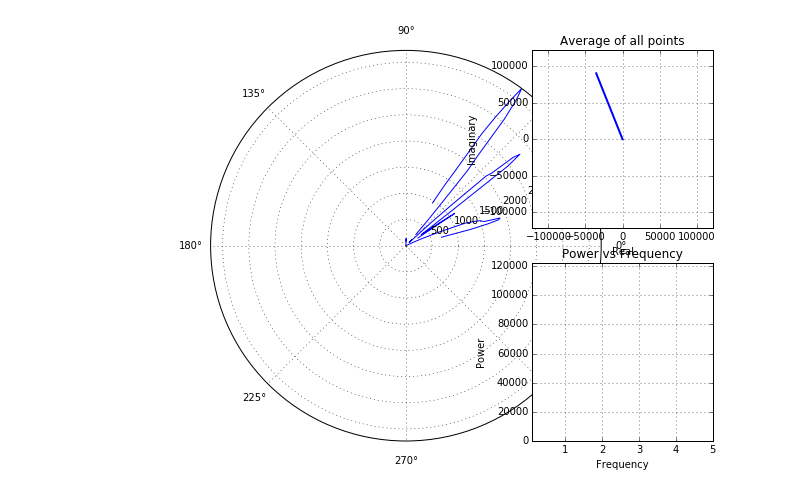
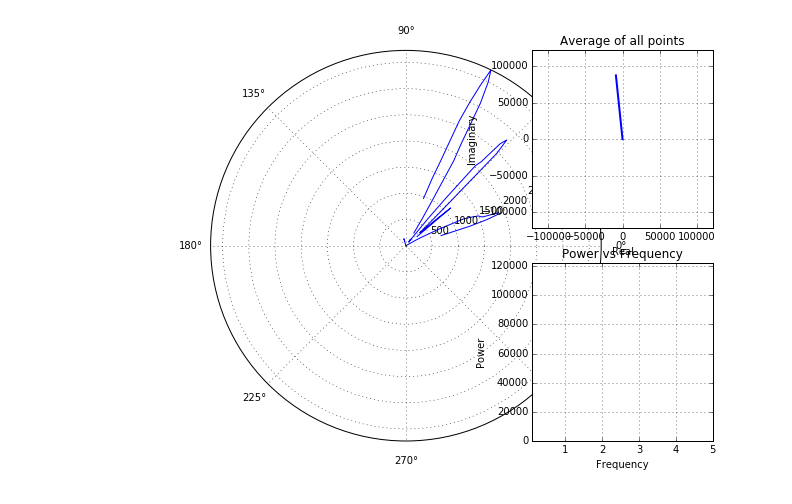
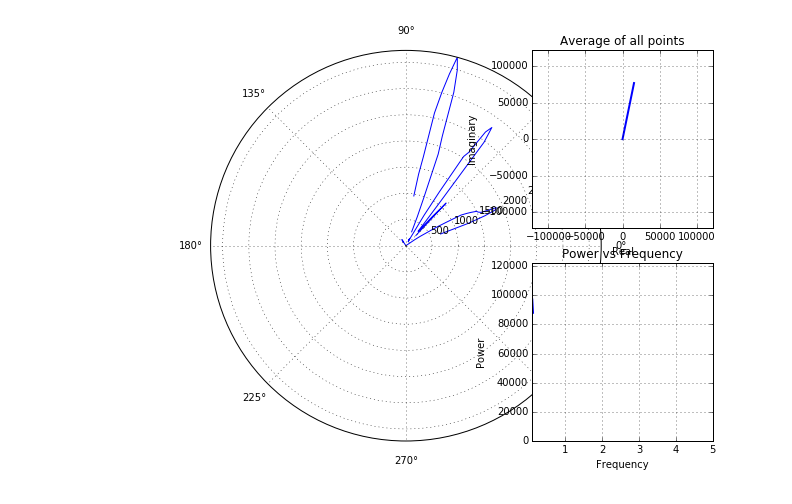
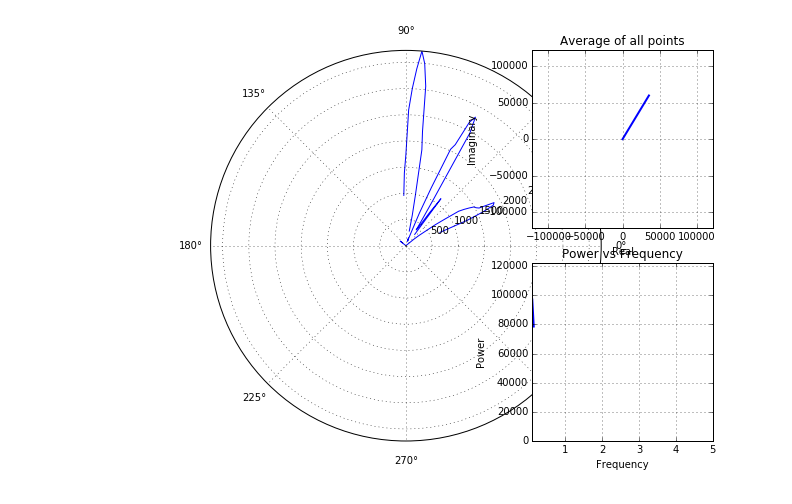
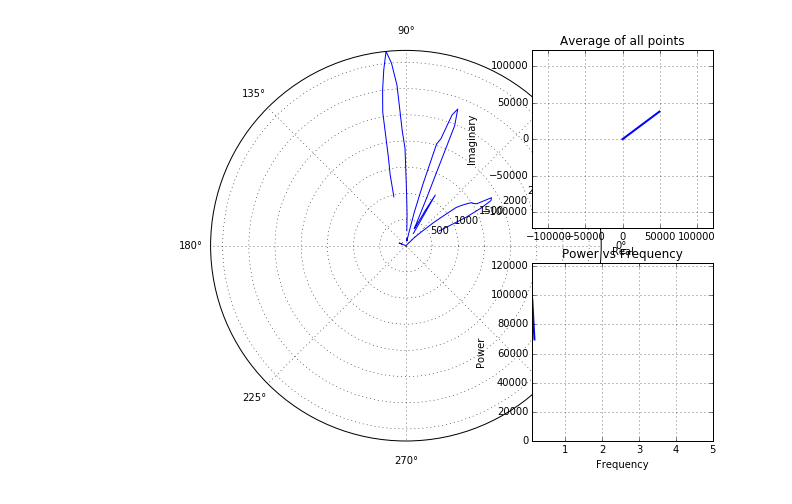
...
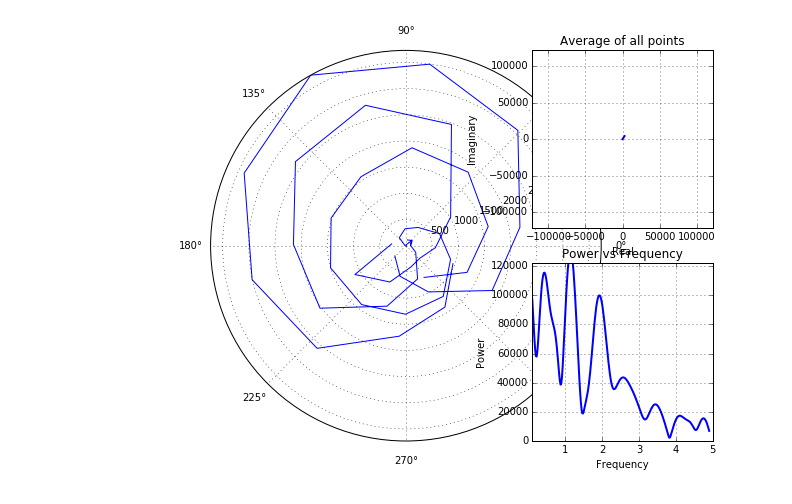
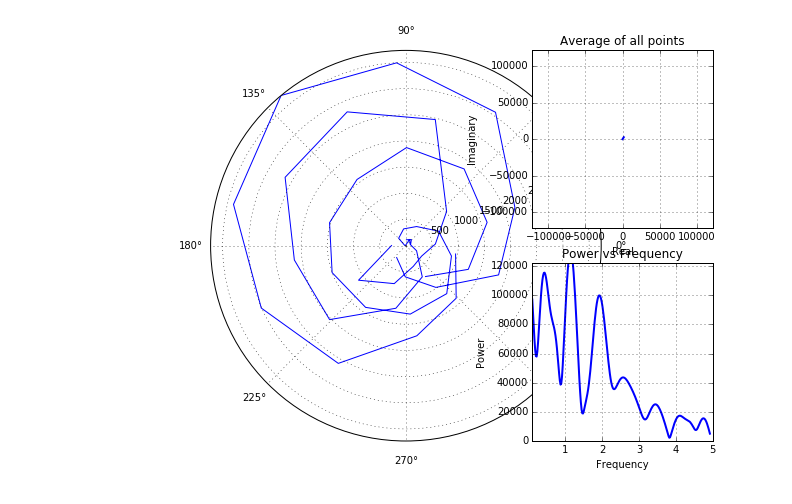
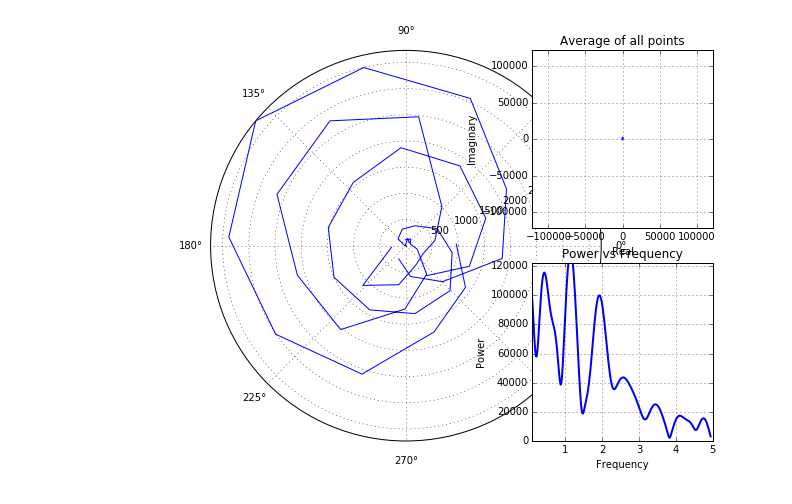
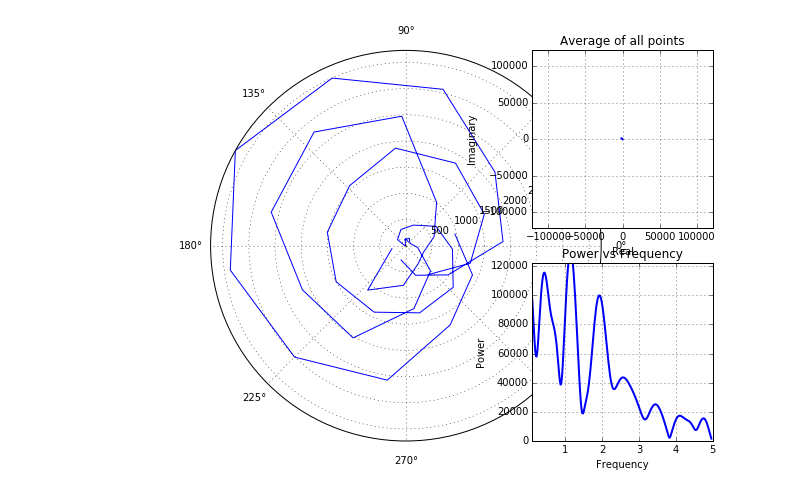
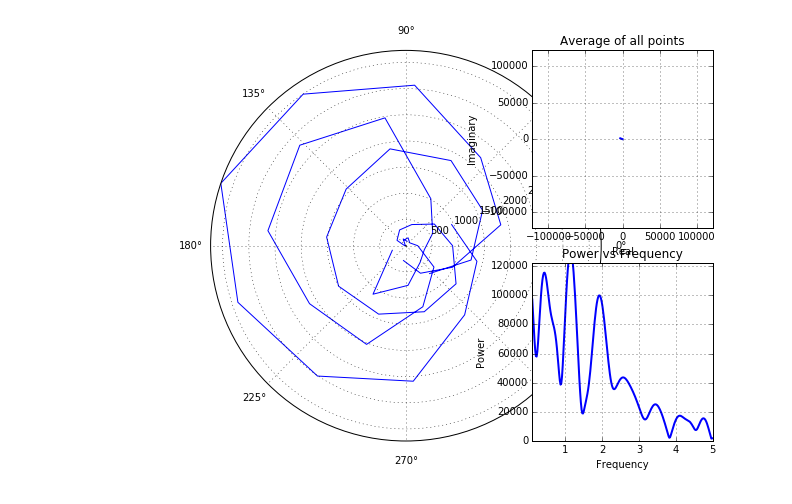

In [31]:
# JSAnimation import available at https://github.com/jakevdp/JSAnimation
from JSAnimation.IPython_display import display_animation
#from JSAnimation import IPython_display
from matplotlib import animation
#from JSAnimation import HTMLWriter

max_power = max(np.abs(freqsig))

N_FRAMES = 250
freqs = np.linspace(0.1,5,N_FRAMES)
offset = 4

power = np.zeros((1,N_FRAMES))

ang = 2*np.pi*0.1*t
radius = np.ones(np.shape(ang))*offset

fig = plt.figure(figsize=(11,7))
ax = fig.add_subplot(111,polar=True)
ax.set_ylim(0,max(sig)+offset)
ax.hold(True)
pt1, = ax.plot(ang,radius)

ax2 = fig.add_subplot(233)
ax2.set_xlim((-max_power,max_power))
ax2.set_ylim((-max_power,max_power))
ax2.set_title('Average of all points')
ax2.set_ylabel('Imaginary')
ax2.set_xlabel('Real')
ax2.grid()
pt2, = ax2.plot([0,1],[0,1],lw=2)

ax3 = fig.add_subplot(236)
ax3.set_xlim((freqs.min(),freqs.max()))
ax3.set_ylim(0,max_power)
ax3.set_title('Power vs Frequency')
ax3.set_ylabel('Power')
ax3.set_xlabel('Frequency')
ax3.grid()
pt3, = ax3.plot([0,1],[0,1],lw=2)



def init_f4():
    pt1.set_data(ang,radius)
    pt2.set_data([],[])
    pt3.set_data([],[],ls='steps',lw=2.0)
    return pt1,pt2,pt3,
    

def animate_f4(i):
    cplx_sig = sig*np.exp(2*np.pi*-1j*freqs[i]*t)
    x = [np.real(cplx_sig).sum(), 0]
    y = [np.imag(cplx_sig).sum(), 0]
    power[0,i] = np.sqrt(x[0]**2 + y[0]**2)
    ang = 2*np.pi*freqs[i]*t
    
    radius = np.ones(np.shape(ang))*offset

    pt1.set_data(ang,radius+sig)
    pt2.set_data(x,y)
    pt3.set_data(freqs[:i],power[0,:i])
    
    return pt1,pt2,pt3,

animation.FuncAnimation(fig, animate_f4, \
                        frames=N_FRAMES, interval=200, blit=True)

In [3]:
import numpy as np

t = np.linspace(0,10,100)
f1 = np.sin(2*t)
f2 = np.sin(5*t)* 1/5
plot(t, f1)
plot(t,f2)